In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

data = pd.read_csv('../data/backtest_data_after_regime_prediction.csv')
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)

## Add bollinger bands

In [15]:
# create a moving average
data['ema_20'] = data['Close'].ewm(span=20, adjust=False).mean()

# add a 10-day EMA
data['ema_10'] = data['Close'].ewm(span=10, adjust=False).mean()


In [16]:
# add bollinger bands 1SD from ema_20

# Calculate the standard deviation over the same span
data['stddev_20'] = data['Close'].ewm(span=20, adjust=False).std()

# Calculate the upper Bollinger Band 1SD
data['upper_band_1sd'] = data['ema_20'] + (data['stddev_20'] * 1)

# Calculate the lower Bollinger Band 1SD
data['lower_band_1sd'] = data['ema_20'] - (data['stddev_20'] * 1)

# Calculate the upper Bollinger Band 1.5SD
data['upper_band_1.5sd'] = data['ema_20'] + (data['stddev_20'] * 1.5)

# Calculate the lower Bollinger Band 1.5SD
data['lower_band_1.5sd'] = data['ema_20'] - (data['stddev_20'] * 1.5)

# Calculate the upper Bollinger Band 2SD
data['upper_band_2sd'] = data['ema_20'] + (data['stddev_20'] * 2)

# Calculate the lower Bollinger Band 2SD
data['lower_band_2sd'] = data['ema_20'] - (data['stddev_20'] * 2)

## Add fibonacci levels

In [17]:
# Create new columns for Fibonacci levels
data['fib_level_0.236'] = np.nan
data['fib_level_0.382'] = np.nan
data['fib_level_0.5'] = np.nan  # Added 0.5 level
data['fib_level_0.618'] = np.nan

# Calculate Fibonacci levels for each day
for i in range(251, len(data)):
    window = data.iloc[i-251:i+1]
    low = window['Low'].min()
    high = window['High'].max()
    diff = high - low
    data.loc[data.index[i], 'fib_level_0.236'] = high - 0.236 * diff
    data.loc[data.index[i], 'fib_level_0.382'] = high - 0.382 * diff
    data.loc[data.index[i], 'fib_level_0.5'] = high - 0.5 * diff  # Calculate 0.5 level
    data.loc[data.index[i], 'fib_level_0.618'] = high - 0.618 * diff

## Add MACD

In [18]:
# Define the short and long lookback periods
short_period = 12 #12 day ema
long_period = 26 #26 day ema

# Calculate the short and long period exponential moving averages
data['short_ema'] = data['Close'].ewm(span=short_period, adjust=False).mean()
data['long_ema'] = data['Close'].ewm(span=long_period, adjust=False).mean()

# Calculate the MACD line
data['MACD_line'] = data['short_ema'] - data['long_ema']

# Calculate the signal line
signal_period = 9
data['signal_line'] = data['MACD_line'].ewm(span=signal_period, adjust=False).mean()

# Calculate the MACD histogram
data['MACD_histogram'] = data['MACD_line'] - data['signal_line']

## Add RSI

In [19]:
# Define the lookback period
lookback_period = 14

# Calculate the difference in price
delta = data['Close'].diff()

# Separate positive and negative differences
up, down = delta.copy(), delta.copy()
up[up < 0] = 0
down[down > 0] = 0

# Calculate the average gain and average loss
avg_gain = up.ewm(com=lookback_period-1, min_periods=lookback_period).mean()
avg_loss = abs(down.ewm(com=lookback_period-1, min_periods=lookback_period).mean())

# Calculate RS
RS = avg_gain / avg_loss

# Calculate the RSI
data['RSI'] = 100 - (100 / (1 + RS))

## Add log returns column

In [20]:
# Calculate the log returns
data['log_returns'] = np.log(data['Close'] .pct_change() + 1)

data.tail()

,regime,Volume,Open,High,Low,Close,ema_20,ema_10,stddev_20,upper_band_1sd,...,fib_level_0.382,fib_level_0.5,fib_level_0.618,short_ema,long_ema,MACD_line,signal_line,MACD_histogram,RSI,log_returns
Date,,,,,,,,,,,,,,,,,,,,,
2024-03-01,blue,4748110000,5098.51,5140.33,5094.16,5137.08,5020.372353,5067.778869,99.135148,5119.507500,...,4631.70846,4474.595,4317.48154,5057.907372,4993.257683,64.649689,62.203756,2.445934,70.387004,0.007976
2024-03-04,blue,4758440000,5130.99,5149.67,5127.18,5130.95,5030.903557,5079.264529,100.004307,5130.907864,...,4637.48058,4479.265,4321.04942,5069.144699,5003.457114,65.687586,62.900522,2.787064,69.220176,-0.001194
2024-03-05,blue,4418410000,5110.52,5114.54,5056.82,5078.65,5035.450838,5079.152796,96.203825,5131.654663,...,4637.48058,4479.265,4321.04942,5070.607053,5009.026957,61.580096,62.636436,-1.056340,60.070572,-0.010245
2024-03-06,blue,4559050000,5108.03,5127.97,5092.22,5104.76,5042.051710,5083.808652,93.858648,5135.910358,...,4637.48058,4479.265,4321.04942,5075.861353,5016.118294,59.743059,62.057761,-2.314702,62.719904,0.005128
2024-03-07,blue,4137980000,5132.38,5165.62,5128.21,5157.36,5053.033452,5097.181624,95.793724,5148.827176,...,4647.33768,4487.240,4327.14232,5088.399606,5026.580642,61.818964,62.010002,-0.191038,67.411035,0.010251


## Export file

In [21]:
data.to_csv('../data/backtest_data_with_technical_indicators.csv')

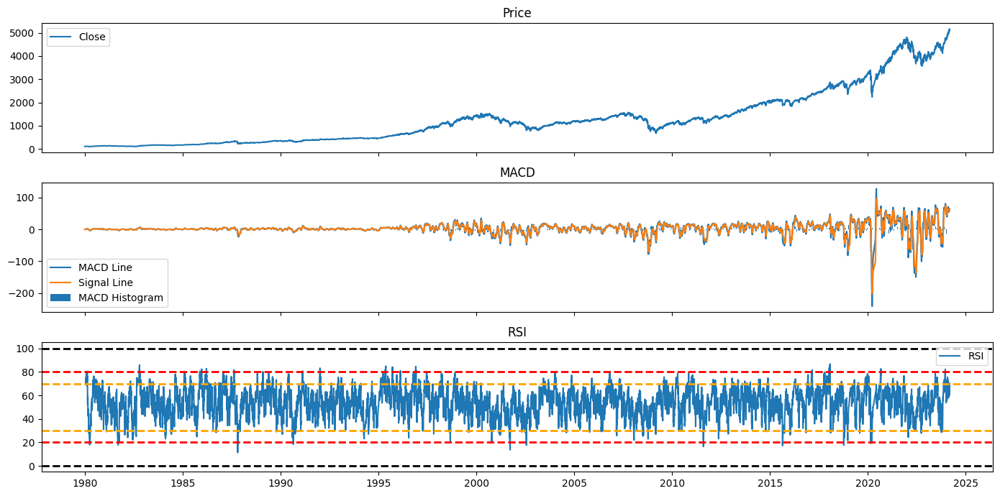

In [10]:
import matplotlib.pyplot as plt

# Create subplots
fig, (ax1, ax2, ax3) = plt.subplots(3, sharex=True, figsize=(14, 7))

# Plot price
ax1.plot(data.index, data['Close'], label='Close')
ax1.set_title('Price')
ax1.legend()

# Plot MACD
ax2.plot(data.index, data['MACD_line'], label='MACD Line')
ax2.plot(data.index, data['signal_line'], label='Signal Line')
ax2.bar(data.index, data['MACD_histogram'], label='MACD Histogram')
ax2.set_title('MACD')
ax2.legend()

# Plot RSI
ax3.plot(data.index, data['RSI'], label='RSI')
ax3.axhline(0, color='black', linewidth=2, linestyle='--')
ax3.axhline(20, color='red', linewidth=2, linestyle='--')
ax3.axhline(30, color='orange', linewidth=2, linestyle='--')
ax3.axhline(70, color='orange', linewidth=2, linestyle='--')
ax3.axhline(80, color='red', linewidth=2, linestyle='--')
ax3.axhline(100, color='black', linewidth=2, linestyle='--')
ax3.set_title('RSI')
ax3.legend()

# Show the plot
plt.tight_layout()
plt.show()

## Price trends for Bollinger Band Indicator

/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_3460/281235646.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_3460/281235646.py:22: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like

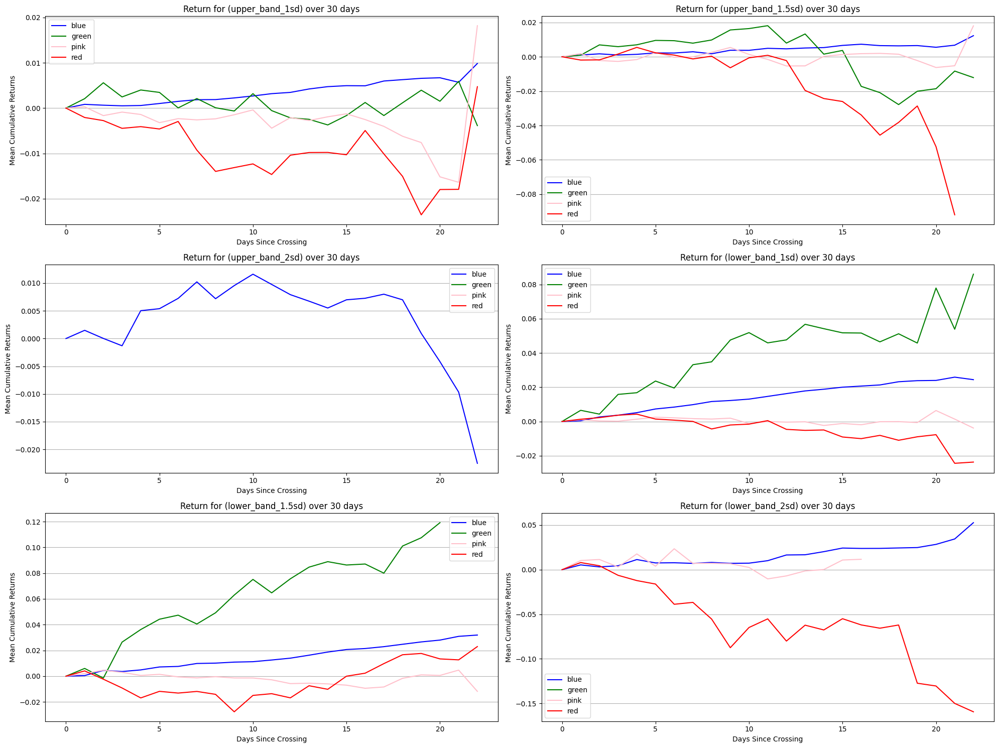

In [32]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
bands = ['upper_band_1sd', 'upper_band_1.5sd', 'upper_band_2sd', 'lower_band_1sd', 'lower_band_1.5sd', 'lower_band_2sd']
rows = len(bands)//2+len(bands)%2
mean_returns = {band: {} for band in bands}

for band in bands:
    if 'upper' in band:
        data[f'cross_{band}'] = (data['Close'] > data[band]) & (data['Close'].shift(1) < data[band].shift(1))
    else:
        data[f'cross_{band}'] = (data['Close'] < data[band]) & (data['Close'].shift(1) > data[band].shift(1))
    crossings = data[data[f'cross_{band}']]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[band][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(20, 15))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, band in zip(axs, bands):
    for regime, returns in mean_returns[band].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({band}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')  # Add horizontal grid lines

plt.tight_layout()
plt.show()

In [34]:
data.tail()

,regime,Volume,Open,High,Low,Close,ema_20,ema_10,stddev_20,upper_band_1sd,...,signal_line,MACD_histogram,RSI,log_returns,cross_upper_band_1sd,cross_upper_band_1.5sd,cross_upper_band_2sd,cross_lower_band_1sd,cross_lower_band_1.5sd,cross_lower_band_2sd
Date,,,,,,,,,,,,,,,,,,,,,
2024-03-01,blue,4748110000,5098.51,5140.33,5094.16,5137.08,5020.372353,5067.778869,99.135148,5119.507500,...,62.203756,2.445934,70.387004,0.007976,True,False,False,False,False,False
2024-03-04,blue,4758440000,5130.99,5149.67,5127.18,5130.95,5030.903557,5079.264529,100.004307,5130.907864,...,62.900522,2.787064,69.220176,-0.001194,False,False,False,False,False,False
2024-03-05,blue,4418410000,5110.52,5114.54,5056.82,5078.65,5035.450838,5079.152796,96.203825,5131.654663,...,62.636436,-1.056340,60.070572,-0.010245,False,False,False,False,False,False
2024-03-06,blue,4559050000,5108.03,5127.97,5092.22,5104.76,5042.051710,5083.808652,93.858648,5135.910358,...,62.057761,-2.314702,62.719904,0.005128,False,False,False,False,False,False
2024-03-07,blue,4137980000,5132.38,5165.62,5128.21,5157.36,5053.033452,5097.181624,95.793724,5148.827176,...,62.010002,-0.191038,67.411035,0.010251,True,False,False,False,False,False


Upper band crossover 1SD - SHORT Bearish high var, SHORT Bullish high var  
Upper band crossover 1.5SD - LONG Bullish high var SHORT Bearish high var  
Upper band crossover 2SD - LONG Bullish low and high var  
Lower band crossover 1SD - SHORT Bearish high var LONG Bullish low var  
Lower band crossover 1.5SD - Short Bearish high var LONG Bearish and Bullish low var  
Lower band crossover 2SD - Short Bearish High var LONG Bullish low var  

LONG Bearish high var -  
LONG Bearish low var - Lower band crossover 1.5SD  
LONG Bullish high var -  Upper band crossover 1.5SD, Upper band Crossover 2SD  
LONG Bullish low var - Lower band crossover 1SD, , Lower band crossover 1.5SD, Lower band crossover 2SD, Upper band crossover 2SD  
SHORT Bearish low var -  
SHORT Bearish high var - Lower band crossover 1SD, Lower band crossover 1.5SD, Lower band crossover 2SD, Upper band crossover 1SD, Upper band crossover 1.5SD  
SHORT Bullish low var -   
SHORT Bullish high var -  Upper band crossover 1SD


## Price trends for fibonacci levels

/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_91396/3247961935.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_91396/3247961935.py:19: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, 

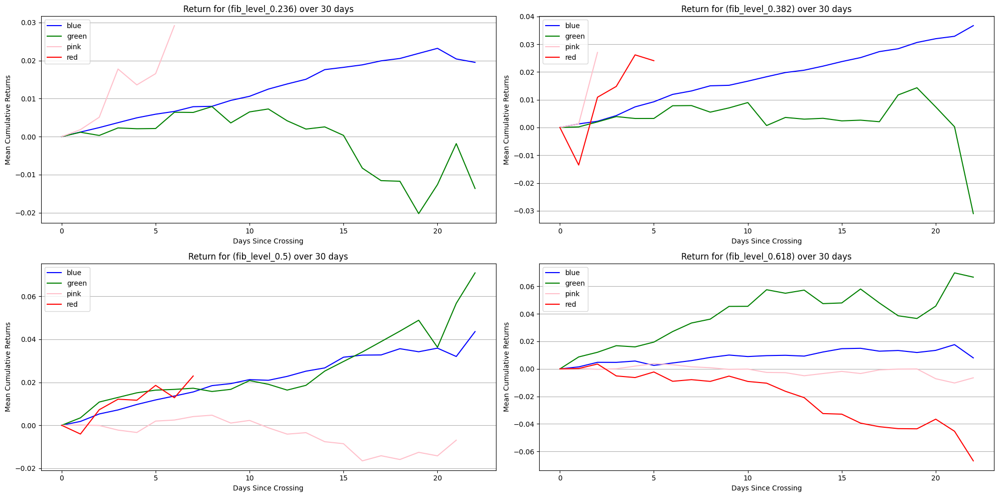

In [11]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
fib_levels = ['fib_level_0.236', 'fib_level_0.382', 'fib_level_0.5','fib_level_0.618']
rows = len(fib_levels)//2+len(fib_levels)%2
mean_returns = {level: {} for level in fib_levels}

for level in fib_levels:
    data[f'cross_{level}'] = (data['Close'] < data[level]) & (data['Close'].shift(1) > data[level].shift(1))  # Change here
    crossings = data[data[f'cross_{level}']]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[level][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(20, 10))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, level in zip(axs, fib_levels):
    for regime, returns in mean_returns[level].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({level}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout()
plt.show()

Fib 0.236 - LONG Bearish and Bullish low var  
Fib 0.382 - LONG Bullish low var  
Fib 0.5 - LONG Bullish high var and low var and LONG bearish high var  
Fib 0.618 - LONG Bullish high var and SHORT Bearish high var  

LONG Bearish low var - Fib 0.236  
LONG Bearish high var -  Fib 0.5, Fib 0.382  
LONG Bullish low var -  Fib 0.382, Fib 0.5, 0.236  
LONG Bullish high var -  Fib 0.5, Fib 0.618  
SHORT Bearish low var - Fib 0.5   
SHORT Bearish high var - Fib 0.618  
SHORT Bullish low var -   
SHORT Bullish high var -  


## Price trends for MACD Indicator

/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_91396/1435909846.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_91396/1435909846.py:22: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, 

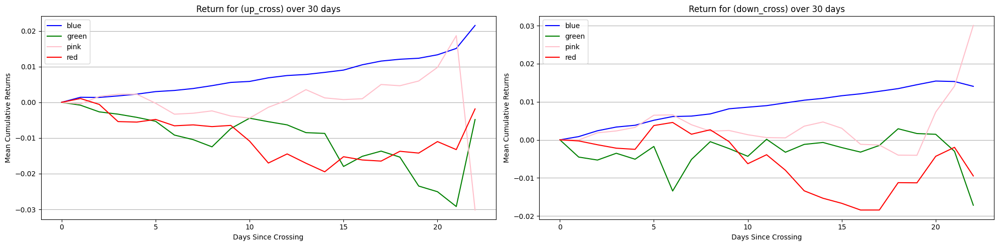

In [12]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
macd_crosses = ['up_cross', 'down_cross']
mean_returns = {cross: {} for cross in macd_crosses}
rows = len(macd_crosses)//2+len(macd_crosses)%2

# Define up and down crossovers
data['up_cross'] = (data['MACD_histogram'] > 0) & (data['MACD_histogram'].shift(1) < 0)
data['down_cross'] = (data['MACD_histogram'] < 0) & (data['MACD_histogram'].shift(1) > 0)

for cross in macd_crosses:
    crossings = data[data[cross]]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[cross][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(20, 5))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, cross in zip(axs, macd_crosses):
    for regime, returns in mean_returns[cross].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({cross}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout()
plt.show()

MACD Up crossover - LONG Bullish low var
MACD Down crossover - LONG Bullish low var, SHORT 

Up cross - SHORT Bullish and bearish high var

## Price trends for RSI

/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_91396/1400257162.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_91396/1400257162.py:24: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, 

/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_91396/1400257162.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1
/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_91396/1400257162.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/7r/gmcfwl7x7f35wnm9l7114rtw0000gn/T/ipykernel_91396/1400257162.py:24: FutureWarning: ChainedAssignmen

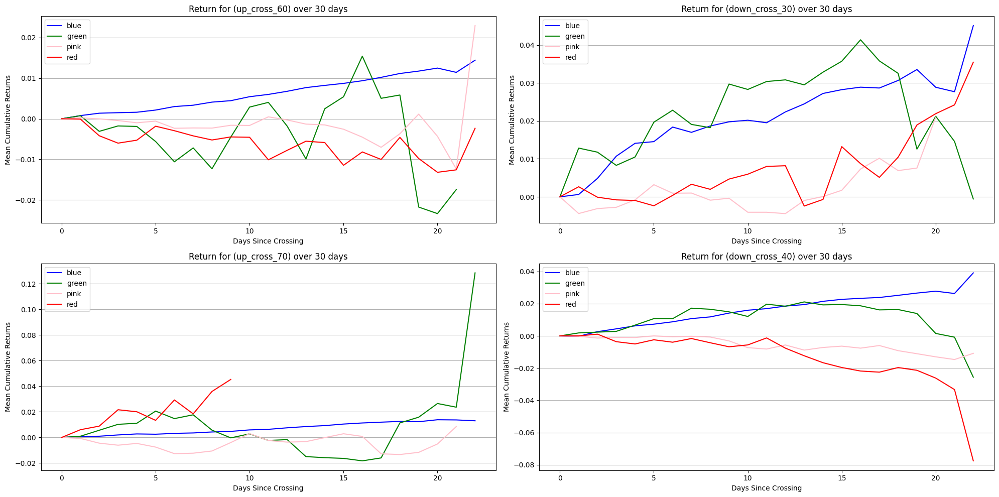

In [13]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
rsi_crosses = ['up_cross_60', 'down_cross_30', 'up_cross_70', 'down_cross_40']
rows = len(rsi_crosses)//2+len(rsi_crosses)%2
mean_returns = {cross: {} for cross in rsi_crosses}

# Define up and down crossovers
data['up_cross_60'] = (data['RSI'] > 60) & (data['RSI'].shift(1) < 60)
data['down_cross_30'] = (data['RSI'] < 30) & (data['RSI'].shift(1) > 30)
data['up_cross_70'] = (data['RSI'] > 70) & (data['RSI'].shift(1) < 70)
data['down_cross_40'] = (data['RSI'] < 40) & (data['RSI'].shift(1) > 40)

for cross in rsi_crosses:
    crossings = data[data[cross]]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[cross][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(20, 10))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, cross in zip(axs, rsi_crosses):
    for regime, returns in mean_returns[cross].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({cross}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout()
plt.show()

RSI Up 60 - LONG bullish low var SHORT bearish high var  
RSI Down 30 - LONG Bullish high and low var LONG bearish low var
RSI Down 40 - SHORT Bearish high var  

SHORT Bearish low var -  
SHORT Bearish high var - RSI 40, 60  
SHORT Bullish low var -  
SHORT Bullish high var - RSI 60 
LONG Bearish low var - RSI 30?  
LONG Bearish high var - RSI 30, 70  
LONG Bullihs low var - All, especially RSI 30 and 40  
LONG Bullish high var - RSI 30  

In [29]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Filter the data for the blue regime
data_regime = data[data['regime'] == 'blue']

# Initialize variables
trade_active = False
entry_price = 0
returns = []
all_returns = []

# Loop over each row in the data
for i in range(1, len(data_regime)):
    # Check for crossover
    if data_regime['Close'].iloc[i] > data_regime['upper_band_1sd'].iloc[i] and data_regime['Close'].iloc[i-1] <= data_regime['upper_band_1sd'].iloc[i-1]:
        # Enter a trade if no trade is currently active
        if not trade_active:
            trade_active = True
            entry_price = data_regime['Close'].iloc[i]
            entry_date = data_regime.index[i]
            returns = [np.nan]*30  # Initialize returns for this trade with NaN

    # Record daily log returns while trade is active
    if trade_active:
        daily_return = np.log(data_regime['Close'].iloc[i] / entry_price)
        returns[(data_regime.index[i] - entry_date).days] = daily_return

    # Check for trade exit conditions
    if trade_active and ((data_regime.index[i] - entry_date).days >= 30 or data['regime'].iloc[i] != 'blue'):
        # Exit the trade
        trade_active = False
        all_returns.append(returns)  # Store returns for this trade
        
    print("1"+str(data_regime.index[i]))
    print("2"+str(data['regime'].iloc[i]))

# Convert all_returns to a DataFrame
df_returns = pd.DataFrame(all_returns)

# Calculate the mean return at each timestep
mean_returns = df_returns.mean()

# # Create a figure and a set of subplots
# fig, ax = plt.subplots()

# # Plot the mean returns
# ax.plot(range(len(mean_returns)), mean_returns)

# # Set the labels and title
# ax.set_xlabel('Day of Trade')
# ax.set_ylabel('Mean Return')
# ax.set_title('Mean Return over Time for Each Trade')

# # Display the plot
# plt.show()



11979-08-03 00:00:00
11979-08-06 00:00:00
11979-08-07 00:00:00
11979-08-08 00:00:00
11979-08-09 00:00:00
11979-08-10 00:00:00
11979-08-13 00:00:00
11979-08-14 00:00:00
11979-08-15 00:00:00
11979-08-16 00:00:00
11979-08-17 00:00:00
11979-08-20 00:00:00
11979-08-21 00:00:00
11979-08-22 00:00:00
11979-08-23 00:00:00
11979-08-24 00:00:00
11979-08-27 00:00:00
11979-08-28 00:00:00
11979-08-29 00:00:00
11979-08-30 00:00:00
11979-08-31 00:00:00
11979-09-04 00:00:00


IndexError: list assignment index out of range

In [17]:
results

,upper_band_1sd,upper_band_1.5sd,upper_band_2sd,lower_band_1sd,lower_band_1.5sd,lower_band_2sd
blue,0.004485,0.006017,-0.001494,0.011092,0.010801,0.025074
green,0.002086,0.002225,NaN,0.002110,0.000000,0.000000
pink,-0.000549,0.002961,0.000000,0.014803,-0.001304,0.147440
red,0.000000,0.000000,NaN,0.000000,0.002755,0.000000
